# Plotting invariant sets for periodic type wind-tree models

In [1]:
from surface_dynamics import *
import sympy as sp

RF = RealField(256)

## Find periodic parameters for genus 2 surface $Y$

We find a periodic type IET corresponding to the flow on $Y$ by manually taking a loop in the Rauzy graph. Then we need to check whether this in fact corresponds to some parameters $(a,b,t)$.

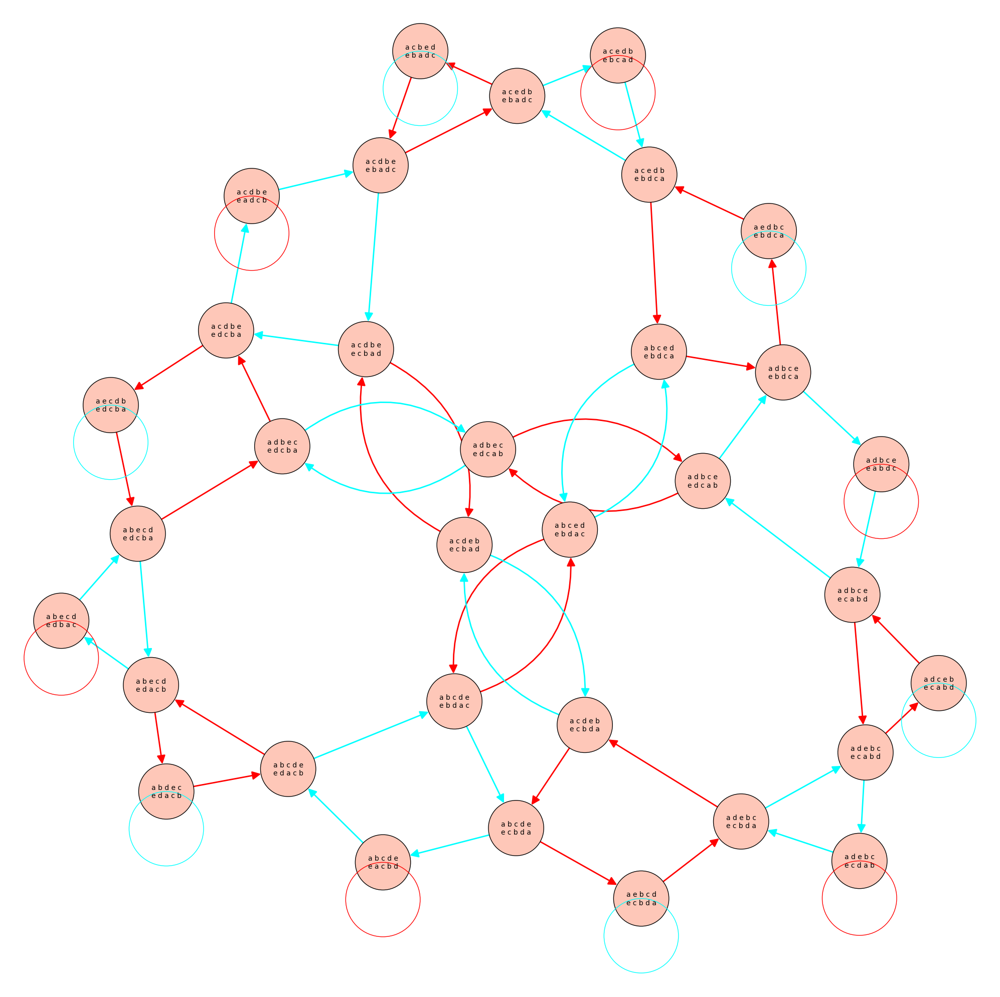

In [2]:
perm_Y = iet.Permutation('a b c d e','e a c b d')
d = perm_Y.rauzy_diagram()
d.graph().show(color_by_label=true,figsize=30,layout='spring',iterations=200)

In [3]:
perm_Y = iet.Permutation('a b c d e','e a c b d')
path = ['t', 't', 'b', 't', 'b', 't', 't','b','t','b','t','b','b','t']        
A = iet.FlipSequence(perm_Y,path).matrix()
A = matrix(SR,A)
eig = A.eigenvectors_right()
eig.sort(key=lambda eigenspace: eigenspace[0])
maxevec = eig[-1][1][0]
maxevec = maxevec/sum(maxevec)
param_a = RF(maxevec[1])
param_t = RF(1/(maxevec[4]+1-param_a))
param_b = RF(param_t*(-maxevec[2]+(1-param_a)))

## Construct IET for the flow on $X$ with parameters found above

In [4]:
#Define the linear flow on the genus 5 fourfold cover surface
#Denote the four copies of the genus 2 surface by (0,0), (1,0), (0,1), (0,0)
#Start from point (x,y) in a given copy and go forwards until intersection with boundary

a = param_a
b = param_b
t = param_t

def forward(x,y,copy):
    #Find the first intersections with the four possible sides, variable "side" is the 
    #horizontal distance until intersection
    
    #We also record the number of intersections with outer edges, this will be useful for
    #finding the cocycle determining the cover
    
    intersections = {}
    for c in [(0,0),(1,0),(0,1),(1,1)]:
        intersections[('h',c)] = 0
        intersections[('v',c)] = 0
        
    
    #inner vertical
    if x < (1-a)/2:        
        #check really hit inner edge rather than its extension
        innerv = (1-a)/2 - x
        if y+innerv*t >= (1-b)/2 and y+innerv*t <= (1+b)/2:
            pass
        else:
            innerv = Infinity
        
    else:
        innerv = Infinity
        
    #inner horizontal
    if y < (1-b)/2:
        #check really hit inner edge rather than its extension
        innerh = ((1-b)/2 - y)/t
        if x+innerh >= (1-a)/2 and x+innerh <= (1+a)/2:
            pass
        else:
            innerh = Infinity
    
    else:
        innerh = Infinity
        
   #outer vertical
    outerv = 1-x
    
    #outer horizontal
    outerh = (1-y)/t
    
    
    #find minimum to see which intersection happens
    if min(innerv,innerh,outerv,outerh) == innerv:
        
        hitx = (1-a)/2
        hity = y+innerv*t
        
        newx = (1+a)/2 #jump to glued edge
        newy = y+innerv*t
        newcopy = ((copy[0]+1) % 2, copy[1])

    
    if min(innerv,innerh,outerv,outerh) == innerh:
        
        hitx = x+innerh
        hity = (1-b)/2
        
        newx = x+innerh
        newy = (1+b)/2
        newcopy = (copy[0], (copy[1]+1) % 2)

    
    if min(innerv,innerh,outerv,outerh) == outerv:
        
        hitx = 1
        hity = y+outerv*t
        
        newx = 0
        newy = y+outerv*t
        newcopy = copy
        
        intersections[('v',copy)] += 1

    
    if min(innerv,innerh,outerv,outerh) == outerh:
        
        hitx = x+outerh
        hity = 1
        
        newx = x+outerh
        newy = 0
        newcopy = copy
        
        intersections[('h',copy)] += 1
    
    #return 2 points: before and after gluing
    return((hitx,hity,copy),(newx,newy,newcopy),intersections)


def backward(x,y,copy):
    #Flowing backwards
    
    #inner vertical
    if x > (1+a)/2:        
        #check really hit inner edge rather than its extension
        innerv = x - (1+a)/2
        if y-innerv*t >= (1-b)/2 and y-innerv*t <= (1+b)/2:
            pass
        else:
            innerv = Infinity
        
    else:
        innerv = Infinity
        
    #inner horizontal
    if y > (1+b)/2:
        #check really hit inner edge rather than its extension
        innerh = (y - (1+b)/2)/t
        if x-innerh >= (1-a)/2 and x-innerh <= (1+a)/2:
            pass
        else:
            innerh = Infinity
    
    else:
        innerh = Infinity
        
   #outer vertical
    outerv = x
    
    #outer horizontal
    outerh = (y)/t
    
    
    #find minimum to see which intersection happens
    if min(innerv,innerh,outerv,outerh) == innerv:
        
        hitx = (1+a)/2
        hity = y-innerv*t
        
        newx = (1-a)/2 #jump to glued edge
        newy = y-innerv*t
        newcopy = ((copy[0]+1) % 2, copy[1])

    
    if min(innerv,innerh,outerv,outerh) == innerh:
        
        hitx = x-innerh
        hity = (1+b)/2
        
        newx = x-innerh
        newy = (1-b)/2
        newcopy = (copy[0], (copy[1]+1) % 2)

    
    if min(innerv,innerh,outerv,outerh) == outerv:
        
        hitx = 0
        hity = y-outerv*t
        
        newx = 1
        newy = y-outerv*t
        newcopy = copy

    
    if min(innerv,innerh,outerv,outerh) == outerh:
        
        hitx = x-outerh
        hity = 0
        
        newx = x-outerh
        newy = 1
        newcopy = copy
    
    #return 2 points: before and after gluing
    return((hitx,hity,copy),(newx,newy,newcopy))
    
    
def section_fwd(x,y,copy):
    #flow forward until Poincare section, recording the number of interseections with edges
    
    intersections = {}
    for c in [(0,0),(1,0),(0,1),(1,1)]:
        intersections[('h',c)] = 0
        intersections[('v',c)] = 0
    
    ((x,y,copy),step_intersections) = forward(x,y,copy)[1:]
    for curve in intersections.keys():
        intersections[curve] += step_intersections[curve]
    
    while True:
        if y == 0 and copy == (0,0):
            return (x,intersections)
        else:
            ((x,y,copy),step_intersections) = forward(x,y,copy)[1:]
            for curve in intersections.keys():
                intersections[curve] += step_intersections[curve]            

def section_back(x,y,copy):
    #flow backward until Poincare section
    (x,y,copy) = backward(x,y,copy)[1]
    
    while True:
        if y == 1 and copy == (0,0):
            return x
        else:
            (x,y,copy) = backward(x,y,copy)[1]

Find the IET

In [5]:
#Lengths

#Find the forwards discontinuities of the IET by flowing backwards from the corner

discont = []
vertices = [((1-a)/2,(1-b)/2),((1+a)/2,(1-b)/2),((1-a)/2,(1+b)/2)]
for i in range(2):
    for j in range(2):
        copy = (i,j)
        for v in vertices:
            (x,y) = v
            discont.append(section_back(x,y,copy))
discont.append(section_back(1,1,(0,0)))   #end of section      

discont.sort()
discont = [0] + discont + [1]
lengths0 = [discont[i+1] - discont[i] for i in range (len(discont)-1)]


#Permutation

#for each discontinuity (including 0 but not 1) find its right image
l = min(lengths0)
discont_right_images = [section_fwd(x+l/2,0,(0,0))[0]-(l/2) for x in discont[:-1]]


#Now the permutation is just the order of these images
letters = ['a','b','c','d','e','f','g','h','i','j','k','l','m','n']
unordered = list(zip(letters,discont_right_images))
ordered = sorted(unordered,key = lambda pt: pt[1])
permuted = [letter[0] for letter in ordered]

perm0 = iet.Permutation(letters,permuted)

T0 = iet.IntervalExchangeTransformation(perm0,lengths0)

Find the cocycles $\gamma_h, \gamma_v$ corresponding to the cover

In [6]:
gamma_h = []
gamma_v = []
sigma_h = []
sigma_v = []
for x in discont[:-1]:
    intersections = section_fwd(x+l/2,0,(0,0))[1]

    gamma_h.append(intersections[('v',(0,0))]-intersections[('v',(1,0))]+intersections[('v',(0,1))]-intersections[('v',(1,1))])
    gamma_v.append(intersections[('h',(0,0))]+intersections[('h',(1,0))]-intersections[('h',(0,1))]-intersections[('h',(1,1))])

    sigma_v.append(intersections[('v',(0,0))]+intersections[('v',(1,0))]-intersections[('v',(0,1))]-intersections[('v',(1,1))])
    sigma_h.append(intersections[('h',(0,0))]-intersections[('h',(1,0))]+intersections[('h',(0,1))]-intersections[('h',(1,1))])

gamma_h = vector(gamma_h)
gamma_v = vector(gamma_v)
sigma_h = vector(sigma_h)
sigma_v = vector(sigma_v)

### Find matrix corresponding to the period of Rauzy-Veech induction for $T$

In [7]:
T0 = iet.IntervalExchangeTransformation(perm0,lengths0)
T = T0
path = []
for i in range(1,10000):
    (T,move) = T.rauzy_move(data=True)[:2]
    path.append(move)
    if T.permutation() == perm0:
        print("Found loop of length "+str(i))
        break
A = matrix(iet.FlipSequence(perm0,path).matrix())

Found loop of length 434


In fact taking half the loop we obtain the same permutation up to relabeling

In [8]:
T0 = iet.IntervalExchangeTransformation(perm0,lengths0)
T = T0
path0 = []
for i in range(217):
    (T,move) = T.rauzy_move(data=True)[:2]
    path0.append(move)
print(T.permutation(),"\n",perm0)

a k l g h i d e f m b c j n
n a c b m l e d i h g f k j 
 a b c d e f g h i j k l m n
n a l k j c h g f e d i b m


In [9]:
#Check that indeed just have a relabeling
B = matrix(SR,iet.FlipSequence(perm0,path0,relabelling=[0,10,11,6,7,8,3,4,5,12,1,2,9,13]).matrix())
B^2 == A

True

In [10]:
#Now that we have the matrix e can compute the lengths exactly

Bsp = sp.Matrix(B)
eig = Bsp.eigenvects()
eig.sort(key = lambda espace: espace[0])
lens_evalue = eig[-1][0]
precise_lengths0 = vector(eig[-1][2][0])
precise_lengths0 /= sum(precise_lengths0)

### Find stable vectors

Now that we have the matrix $B$, we can find the stable vectors in the blocks $E^{-+},E^{+-}$ by taking the eignenvectors of $B$. To simplify, we only consider the action of $B$ on the individual blocks, which also allows us to write the stable vectors in the basis $\{\gamma,\sigma\}$ for the corresponding block.

In [11]:
#Find B^T * gamma_h in terms of gamma_h, sigma_h 

#orthogonal vector to gamma_h
gamma_h_orth = sigma_h - (sigma_h*gamma_h)/(gamma_h*gamma_h) *gamma_h

#project onto orthogonal vector to find the sigma_h components, then rest is gamma_h component
image_gamma_h = B.transpose()*gamma_h
c = (image_gamma_h*gamma_h_orth)/(sigma_h*gamma_h_orth)
a = (image_gamma_h-c*sigma_h)*gamma_h/(gamma_h*gamma_h)

image_sigma_h = B.transpose()*sigma_h
d = (image_sigma_h*gamma_h_orth)/(sigma_h*gamma_h_orth)
b = (image_sigma_h-d*sigma_h)*gamma_h/(gamma_h*gamma_h)

#matrix for action of B on the horizontal block
h_matrix = matrix(SR,[[a,b],[c,d]])

#check that the below are equal to 0

# image_gamma_h - h_matrix[0][0]*gamma_h - h_matrix[1][0]*sigma_h == 0
# image_sigma_h - h_matrix[0][1]*gamma_h - h_matrix[1][1]*sigma_h == 0

h_eigenvecs = h_matrix.eigenvectors_right()
h_eigenvecs.sort(key= lambda evec: evec[0])
h_const = (h_eigenvecs[0][1][0][1]/h_eigenvecs[0][1][0][0])  #the sigma entry of the stable eigenvector
h_stable = gamma_h + h_const*sigma_h

In [12]:
#lambda, the scaling factor
lam = h_eigenvecs[0][0]
print(lam)

#check that really stable eigenvector:
[entry.full_simplify() for entry in (B.transpose()*h_stable - lam*h_stable)]

-20*sqrt(6) + 49


[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

In [13]:
#Find B^T * gamma_v in terms of gamma_v, sigma_v

#orthogonal vector to gamma_v
gamma_v_orth = sigma_v - (sigma_v*gamma_v)/(gamma_v*gamma_v) *gamma_v

#project onto orthogonal vector to find the sigma_v components, then rest is gamma_v component
image_gamma_v = B.transpose()*gamma_v
c = (image_gamma_v*gamma_v_orth)/(sigma_v*gamma_v_orth)
a = (image_gamma_v-c*sigma_v)*gamma_v/(gamma_v*gamma_v)

image_sigma_v = B.transpose()*sigma_v
d = (image_sigma_v*gamma_v_orth)/(sigma_v*gamma_v_orth)
b = (image_sigma_v-d*sigma_v)*gamma_v/(gamma_v*gamma_v)

#matrix for action of B on the horizontal block
v_matrix = matrix(SR,[[a,b],[c,d]])

#check that the below are equal to 0

# image_gamma_v - v_matrix[0][0]*gamma_v - v_matrix[1][0]*sigma_v == 0
# image_sigma_v - v_matrix[0][1]*gamma_v - v_matrix[1][1]*sigma_v == 0

v_eigenvecs = v_matrix.eigenvectors_right()
v_eigenvecs.sort(key= lambda evec: evec[0])
v_const = v_eigenvecs[0][1][0][1]/v_eigenvecs[0][1][0][0]  #the sigma entry of the stable eigenvector
v_stable = gamma_v + v_const*sigma_v

In [14]:
#check that really stable eigenvector:
[entry.full_simplify() for entry in (B.transpose()*v_stable - lam*v_stable)]

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

### Transfer functions via Birkhoff sums

Here we plot the transfer functions to see what they look like. For each of the two, we plot the transfer function $h$ and its translate by $c$

In [15]:
#define piecewise constant function corresponding to stable vector
def psi_h(x):
    for i in range(14):
        if x < discont[i+1]:
            return h_stable[i]
        
def psi_v(x):
    for i in range(14):
        if x < discont[i+1]:
            return v_stable[i]

N = 10^4
#values of the transfer functions
x0 = 0
current_h = 0
current_v = 0
x = x0
values_h = [(x,current_h)]
values_v = [(x,current_v)]
for i in range(N):
    current_h += psi_h(x)
    current_v += psi_v(x)
    x = T0(x)
    
    values_h.append((x,current_h))
    values_v.append((x,current_v))

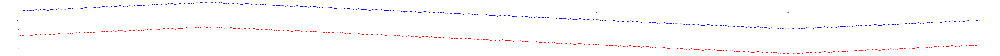

In [16]:
h_plt = points(values_h,figsize=100,aspect_ratio=0.01)+points([(val[0],val[1]+h_const) for val in values_h],color='red')
h_plt

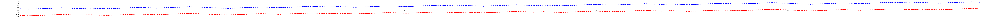

In [17]:
v_plt = points(values_v,figsize=100,aspect_ratio=0.01)+points([(val[0],val[1]+v_const) for val in values_v],color='red')
v_plt

## Transfer functions at endpoints of intervals

Here we find the vectors $\tau$ for each of the two transfer functions, defined as $(\tau)_i = h (x_i) - h (x_{i-1})$, where $x_i$ are the discontinuities of $T$.

We know that the vector $\tau$ is an eigenvector of B with eigenvalue $\lambda^{-1}$. (See Lemma A.1)

The eigenspace with eignavlue $\lambda^{-1}$ is 2-dimensional, so we need to identify our vectors inside this eigenspace.

Consider the permutation and observe that $\pi_b(1) = 14, \pi_b(14) = 13$.
We know that if $\tau_h$ is the eigenvector for the horizontal stable cocycle, then:

$\sum_{i=1}^{13} (\tau_h)_i + h_{14} = h(0) = 0$,

$\sum_{i=1}^{13} (\tau_h)_i + h_{13} = h(1) = \sum_{i=1}^{14} (\tau_h)_i  \implies (\tau_h)_{14} = h_{13}$.

Writing in a basis $\tau_1, \tau_2$ of the eigenspace, let $s_1 = \sum_{i=1}^{13} (\tau_1)_i, s_2 = \sum_{i=1}^{13} (\tau_2)_i$. 

Then if $\tau_h = a \tau_1 + b \tau_2$, we have:
$$ \begin{pmatrix}
s_1 & s_2 \\ (\tau_1)_{14} & (\tau_2)_{14}
\end{pmatrix} 
\begin{pmatrix}
a \\ b
\end{pmatrix} 
=
\begin{pmatrix}
-h_{14} \\ h_{13}
\end{pmatrix}. $$

In [18]:
Bsp = sp.Matrix(B)
eig = Bsp.eigenvects()

for espace in eig:
    if SR(espace[0])*lam == 1 :
        [tau1,tau2] = espace[2]
        break

In [19]:
s_1 = sum(tau1[:13])
s_2 = sum(tau2[:13])
M = matrix(SR,[[s_1,s_2],[tau1[13],tau2[13]]])
(a,b) = M.inverse()*vector([-h_stable[13],h_stable[12]])
tau_h = a*tau1+b*tau2
(c,d) = M.inverse()*vector([-v_stable[13],v_stable[12]])
tau_v = c*tau1+d*tau2

In [20]:
tau_h = vector(SR,tau_h)
tau_v = vector(SR,tau_v)

### Compute max/min values of $h$ for level 0 partition


We use the formula of Proposition 5.3 to find upper and lower bounds of $h$ on each $I_i$.

In [21]:
g = iet.FlipSequence(perm0,path0,relabelling=[0,10,11,6,7,8,3,4,5,12,1,2,9,13])
orbit_sub = g.orbit_substitution
orbit_sub_list = orbit_sub(' ')

interval_sub = g.interval_substitution
interval_sub_list = interval_sub(' ')

In [22]:
#values of the function f_h
#this we do with reals with high precision for speed, symbolic computation is much slower
f_h_values = []
#list, with entry t being {s:[values for edges s->t]}
for t in range(14):
    vals = {i:[] for i in range(14)}
    current = 0
    for s in orbit_sub_list[t]:
        vals[s].append(RF(current))
        current += h_stable[s]
    f_h_values.append(vals)

In [23]:
#max and min of f depending on start and terminus
h_maxmatrix = matrix([[max(f_h_values[j][i])    for j in range(14)] for i in range(14)])
h_minmatrix = matrix([[min(f_h_values[j][i])   for j in range(14)] for i in range(14)])

total_max = max([h_maxmatrix[i][j] for j in range(14) for i in range(14)])
total_min = min([h_minmatrix[i][j] for j in range(14) for i in range(14)])
print("Extrema for f: "+str((total_min,total_max)))

Extrema for f: (-1.974291367869850351808974451293155894823188058130298334761510844497815838545, 0.9844965122062883878632929571753280555042384449968957661076594994786082893959)


We can see that the max absolute value is less than 2, and since $\lambda \approx 0.01$, max value times 
$\frac{\lambda^4}{1-\lambda}$ is less that $3\times10^{-8}$.

So we compute the max and min for four steps and add the error afterwards.

In [24]:
def maxplusproduct(A,B):
    #given matrices A and B return AB in max-plus arithmetic
    
    n = len(list(A))
    
    rows = []
    for i in range(n):
        row = []
        for j in range(n):
            row.append(max([A[i][k]+B[k][j] for k in range(n)]))
        rows.append(row)
        
    return matrix(rows)

def minplusproduct(A,B):
    #given matrices A and B return AB in min-plus arithmetic
    
    n = len(list(A))
    
    rows = []
    for i in range(n):
        row = []
        for j in range(n):
            row.append(min([A[i][k]+B[k][j] for k in range(n)]))
        rows.append(row)
        
    return matrix(rows)

In [25]:
h_max2 = maxplusproduct(h_maxmatrix,lam*h_maxmatrix)
h_max3 = maxplusproduct(h_max2,lam^2*h_maxmatrix)
h_max4 = maxplusproduct(h_max3,lam^3*h_maxmatrix)
h_max_vec = [max(h_max4[i]) for i in range(14)]

In [26]:
h_min2 = minplusproduct(h_minmatrix,lam*h_minmatrix)
h_min3 = minplusproduct(h_min2,lam^2*h_minmatrix)
h_min4 = minplusproduct(h_min3,lam^3*h_minmatrix)
h_min_vec = [max(h_min4[i]) for i in range(14)]

In [27]:
#values of the function f_v
f_v_values = []
#list, with entry t being {s:[values for edges s->t]}
for t in range(14):
    vals = {i:[] for i in range(14)}
    current = 0
    for s in orbit_sub_list[t]:
        vals[s].append(RF(current))
        current += v_stable[s]
    f_v_values.append(vals)

In [28]:
v_maxmatrix = matrix([[max(f_v_values[j][i])    for j in range(14)] for i in range(14)])
v_minmatrix = matrix([[min(f_v_values[j][i])    for j in range(14)] for i in range(14)])

total_max = max([v_maxmatrix[i][j] for j in range(14) for i in range(14)])
total_min = min([v_minmatrix[i][j] for j in range(14) for i in range(14)])
print("Extrema for f: "+str((total_min,total_max)))

Extrema for f: (-0.05643925929693713551019126279916619925695797905930175009814259165278802838182, 0.7709372431646665952379706105474491594426470186321003481763863077354391648243)


In [29]:
v_max2 = maxplusproduct(v_maxmatrix,lam*v_maxmatrix)
v_max3 = maxplusproduct(v_max2,lam^2*v_maxmatrix)
v_max4 = maxplusproduct(v_max3,lam^3*v_maxmatrix)
v_max_vec = [max(v_max4[i]) for i in range(14)]

In [30]:
v_min2 = minplusproduct(v_minmatrix,lam*v_minmatrix)
v_min3 = minplusproduct(v_min2,lam^2*v_minmatrix)
v_min4 = minplusproduct(v_min3,lam^3*v_minmatrix)
v_min_vec = [max(v_min4[i]) for i in range(14)]

### Get bounds on partition

Compute the relative min/max of $h$ on interval $I_i$ compared to the left endpoint: the $i$th entry of h_relmax is $\max_{y\in I_i} h(y) - h(x_i)$. (Up to the error of size $3\times 10^{-8}$)

In [31]:
h_relmax = [float(h_max_vec[i]-sum(tau_h[:i])) for i in range(14)]
h_relmin = [float(h_min_vec[i]-sum(tau_h[:i])) for i in range(14)]
v_relmax = [float(v_max_vec[i]-sum(tau_v[:i])) for i in range(14)]
v_relmin = [float(v_min_vec[i]-sum(tau_v[:i])) for i in range(14)]

Now we compute the min/max bounds on all intervals of the level one partition $\mathcal{P}^{(1)}$. This takes some time! (ca 20 minutes on my computer)

In [32]:
err = 3*10^(-8)
x = 0
current_h = 0
current_v = 0
h_bounds = []
v_bounds = []
for i in range(14):
    print("Computing on interval I_"+str(i))
    for interval in interval_sub_list[i]:
        h_bounds.append((float(x),float(current_h+lam*h_relmin[interval]-err),float(current_h+lam*h_relmax[interval]+err)))
        v_bounds.append((float(x),float(current_v+lam*v_relmin[interval]-err),float(current_v+lam*v_relmax[interval]+err)))

        x += 1/lens_evalue*precise_lengths0[interval]
        current_h += lam*tau_h[interval]
        current_v += lam*tau_v[interval]
            

Computing on interval I_0
Computing on interval I_1
Computing on interval I_2
Computing on interval I_3
Computing on interval I_4
Computing on interval I_5
Computing on interval I_6
Computing on interval I_7
Computing on interval I_8
Computing on interval I_9
Computing on interval I_10
Computing on interval I_11
Computing on interval I_12
Computing on interval I_13


Now we split the intervals into groups and cmpute min/max over each, for faster comparisons later. We do this on two levels.

In [33]:
int_n = len(h_bounds)
bin_n = floor(int_n^(1/3))
ints_per_bin_1 = int_n//(bin_n^2)

#level 1 partition
bin_limits_1 = [(i*ints_per_bin_1,(i+1)*ints_per_bin_1)  for i in range(bin_n^2-1)]+[((bin_n^2-1)*ints_per_bin_1,int_n-1)]

#level 2 partition
ints_per_bin_2 = len(bin_limits_1)//bin_n
bin_limits_2 = [(i*ints_per_bin_2,(i+1)*ints_per_bin_2)  for i in range(bin_n-1)]+[((bin_n-1)*ints_per_bin_2,len(bin_limits_1)-1)]

bin_1_h_bounds = []
bin_1_v_bounds = []
for i in range(bin_n^2):
    (start,end) = bin_limits_1[i]
    min_h = min([bound[1] for bound in h_bounds[start:end]])
    max_h = max([bound[2] for bound in h_bounds[start:end]])
    min_v = min([bound[1] for bound in v_bounds[start:end]])
    max_v = max([bound[2] for bound in v_bounds[start:end]])
    
    bin_1_h_bounds.append((min_h,max_h))
    bin_1_v_bounds.append((min_v,max_v))
    
bin_2_h_bounds = []
bin_2_v_bounds = []
for i in range(bin_n):
    (start,end) = bin_limits_2[i]
    min_h = min([bound[0] for bound in bin_1_h_bounds[start:end]])
    max_h = max([bound[1] for bound in bin_1_h_bounds[start:end]])
    min_v = min([bound[0] for bound in bin_1_v_bounds[start:end]])
    max_v = max([bound[1] for bound in bin_1_v_bounds[start:end]])
    
    bin_2_h_bounds.append((min_h,max_h))
    bin_2_v_bounds.append((min_v,max_v))

Finally we can define the function that we will use to find the level sets of the transfer functions

In [34]:
def check(a_h,a_v):
    #return points x for which both h_x(x)-a_h lies in Z*c_h and similar for v
    #first check the bins, then if in bin for both, check small intervals

    validpts = []
    validbins_1 = []
    validbins_2 = []
    for i in range(len(bin_2_h_bounds)):
        (h_min,h_max) = bin_2_h_bounds[i]
        test1 = float((h_min-a_h)/h_const)
        test2 = float((h_max-a_h)/h_const)
        if floor(test2) != floor(test1):
            (v_min,v_max) = bin_2_v_bounds[i]
            test1 = float((v_min-a_v)/v_const)
            test2 = float((v_max-a_v)/v_const)
            if floor(test2) != floor(test1):
                validbins_2.append(i)

    #check the small bins within the large bin
    for i in validbins_2:
        checkrange = bin_limits_2[i]
        for j in range(checkrange[0],checkrange[1]+1):
            (h_min,h_max) = bin_1_h_bounds[j]
            test1 = float((h_min-a_h)/h_const)
            test2 = float((h_max-a_h)/h_const)
            if floor(test2) != floor(test1):
                (v_min,v_max) = bin_1_v_bounds[j]
                test1 = float((v_min-a_v)/v_const)
                test2 = float((v_max-a_v)/v_const)
                if floor(test2) != floor(test1):
                    validbins_1.append(j)
                    
    #check the intervals within the small bins
    for i in validbins_1:
        checkrange = bin_limits_1[i]
        for j in range(checkrange[0],checkrange[1]+1):
            (x,h_min,h_max) = h_bounds[j]
            test1 = float((h_min-a_h)/h_const)
            test2 = float((h_max-a_h)/h_const)
            if floor(test2) != floor(test1):
                (x,v_min,v_max) = v_bounds[j]
                test1 = float((v_min-a_v)/v_const)
                test2 = float((v_max-a_v)/v_const)
                if floor(test2) != floor(test1):
                    validpts.append(x)
    

    return validpts

# Plot level sets

First we just make a plot of the obstacles in the windtree, and define the billiard map which we will use to plot segments of the trajectory between the hits of the Poincaré section

In [35]:
windtree_plt = plot([],figsize=200)

#make [-N,N]x[-N,N] grid
N = 90

a = param_a
b = param_b

for i in range(-N,N+1):
    for j in range(-N,N+1):
        windtree_plt+=polygon([(i-a/2,j-b/2),(i+a/2,j-b/2),(i+a/2,j+b/2),(i-a/2,j+b/2)],color='black',fill=True,alpha=1,axes=False)
        
        
def bil_map(pt,direction):
    #image of billiard map: next reflection, next direction
    #point given in coordinates, direction is of ray from horizontal
    
    (x0,y0) = pt
    
    
    #compute first intersection with each edge (compute the x-shift) - can be positive or negative
    
    leftint = ceil(x0+a/2)-a/2-x0
    botint = (ceil(y0+b/2)-b/2-y0)/tan(direction)
    rightint = floor(x0-a/2)+a/2-x0
    topint = (floor(y0-b/2)+b/2-y0)/tan(direction)
    
    #find all intersections 
    #left
    lshift = 0
    n = 0
    while lshift == 0:
        shift = leftint+n
        y = y0+tan(direction)*shift

        if abs(round(y)-y)<b/2:
            lshift = shift
            break
        n +=1

    #bottom
    bshift = 0
    n = 0
    while bshift == 0:
        shift = botint+n/tan(direction)
        x = x0+shift

        if abs(round(x)-x)<a/2:
            bshift = shift
            break 
        n +=1

    #right
    rshift = 0
    n = 0
    while rshift == 0:
        shift = rightint+n
        y = y0+tan(direction)*shift

        if abs(round(y)-y)<b/2:
            rshift = shift
            break
        n -= 1

    #top
    tshift = 0
    n = 0
    while tshift == 0:
        shift = topint+n/tan(direction)
        x = x0+shift

        if abs(round(x)-x)<a/2:
            tshift = shift
            break 
        n -= 1      
                
    
    if float(direction/(2*pi)) % 1 < 1/4:
        #possible edges: left, bottom
        if lshift < bshift:
            shift = lshift
            newdir = pi-direction
            
        elif lshift > bshift:
            shift = bshift
            newdir = 2*pi-direction
            
    elif float(direction/(2*pi)) % 1 < 2/4:
        #possible edges: right, bottom
        if rshift > bshift:
            shift = rshift
            newdir = pi-direction
            
        elif rshift < bshift:
            shift = bshift
            newdir = 2*pi-direction
            
    elif float(direction/(2*pi)) % 1 < 3/4:
        #possible edges: right,top
        if rshift > tshift:
            shift = rshift
            newdir = pi-direction
            
        elif rshift < tshift:
            shift = tshift
            newdir = 2*pi-direction
            
    elif float(direction/(2*pi)) % 1 < 4/4:
        #possible edges: left, top
        if lshift < tshift:
            shift = lshift
            newdir = pi-direction
            
        elif lshift > tshift:
            shift = tshift
            newdir = 2*pi-direction
            
        
    x = x0+shift
    y = y0+tan(direction)*shift
    return ((x,y),newdir)

def first_return(pt,direction):
    #first hit of trajectory from pt in given direction to the section deifning IET
    dir0 = direction
    found = False
    pts = [pt]
    while not found:
        (newpt,newdir) = bil_map(pt,direction)
        if abs(float(direction/(2*pi))%1-float(dir0/(2*pi))%1) < 0.1:
            #check if crossed horizontal line of form y = n+0.5
            if floor(pt[1]+0.5) != floor(newpt[1]+0.5):
                found = True
                
        pts.append(newpt)
        (pt,direction) = (newpt,newdir)
        
    return pts

In [36]:
#Fix values of h to plot the level set
h0val = 0.2
v0val = -0.2

N=120
#Will look for the level set on the square [-N,N]x[-N,N]

#It's better to take this N larger than the N above, as around the edges we will miss parts of the 
#trajectory that don't hit the Poincaré section inside the box

valid_pts = {}

for a_h in range(-N, N+1):
    print("Computing column "+str(a_h))
    for a_v in range(-N, N+1):

        square = (a_h,a_v)
        newvalid = []
        for pt in check(a_h+h0val,a_v+v0val):        
            newvalid.append(pt)

        if newvalid != []:
            valid_pts[square] = newvalid
            
        
#To get the coordinates for plotting we need to shift by (-0.5,-0.5)
plot_pts = [(float(-0.5+x+square[0]),float(-0.5+square[1])) for square in valid_pts.keys() for x in valid_pts[square]]

theta = atan(param_t)

print("Plotting")
plt_copy = windtree_plt
for pt in plot_pts:
    
    #plot first return to the section
    traj = first_return(pt,float(theta))
    for i in range(len(traj)-1):
        plt_copy += line([traj[i],traj[i+1]],color='mediumblue',thickness=5)
        
plt_copy

Computing column -120
Computing column -119
Computing column -118
Computing column -117
Computing column -116
Computing column -115
Computing column -114
Computing column -113
Computing column -112
Computing column -111
Computing column -110
Computing column -109
Computing column -108
Computing column -107
Computing column -106
Computing column -105
Computing column -104
Computing column -103
Computing column -102
Computing column -101
Computing column -100
Computing column -99
Computing column -98
Computing column -97
Computing column -96
Computing column -95
Computing column -94
Computing column -93
Computing column -92
Computing column -91
Computing column -90
Computing column -89
Computing column -88
Computing column -87
Computing column -86
Computing column -85
Computing column -84
Computing column -83
Computing column -82
Computing column -81
Computing column -80
Computing column -79
Computing column -78
Computing column -77
Computing column -76
Computing column -75
Computing col